<a href="https://colab.research.google.com/github/akimi-yano/Helmets_and_Vests_Object_Detection/blob/main/Helmets_and_Vests_Object_Detection_TensorFlow.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# Helmets and Vests Object Detection TensorFlow

In [ ]:
!pip install pycocotools

In [ ]:
!pip install keras-cv

   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 650.7/650.7 kB 26.5 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 950.8/950.8 kB 52.1 MB/s eta 0:00:00


In [ ]:
import tensorflow as tf
import keras

print(tf.__version__)
print(keras.__version__)

2.18.0
3.8.0


In [ ]:
import os
import glob
import random
import requests
from zipfile import ZipFile
import shutil
import xml.etree.ElementTree as ET
import glob

from dataclasses import dataclass, field
from tqdm import tqdm
import numpy as np
import cv2

import keras_cv
from keras_cv import bounding_box
import tensorflow as tf
import matplotlib.pyplot as plt
from matplotlib.ticker import MaxNLocator

import pprint
import warnings
warnings.filterwarnings("ignore")

In [ ]:
%matplotlib inline
block_plot = False

bold = f"\033[1m"  #for font styling
reset = f"\033[0m"

In [ ]:
def system_config(SEED_VALUE):

    random.seed(SEED_VALUE)

    np.random.seed(SEED_VALUE)

    tf.random.set_seed(SEED_VALUE)
    tf.keras.utils.set_random_seed(SEED_VALUE)

    # Get list of GPUs.
    gpu_devices = tf.config.list_physical_devices('GPU')

    if gpu_devices:
        os.environ["CUDA_VISIBLE_DEVICES"] = '0'
        os.environ['TF_CUDNN_DETERMINISTIC'] = '1'

        # Grow the memory usage as the process needs it.
        tf.config.experimental.set_memory_growth(gpu_devices[0], True)

        # Enable using cudNN.
        os.environ['TF_USE_CUDNN'] = "true"

system_config(SEED_VALUE=42)

# Download the Dataset


**Download the CHV (Colored Helmet and Vest) PPE Kit Dataset from  [here](https://www.dropbox.com/s/87e87h3kpw41iwj/Project_4_CHV_Dataset.zip?dl=1). Unzip it to get the `Project_3_CHV_Dataset` directory.**


The directory structure:

```html
Project_3_CHV_Dataset
|___data
|   |___testing
|   |___training
|___README.txt  
```

* ***Directory Details:***
    - **training**:Contains a total of `1080` JPEG images, along with corresponding XML annotations to be used for training.
    - **testing**:  Contains a total of `250` JPEG images, along with corresponding XML annotations to be used for final evaluation.
* ***Classes:***
    - The dataset contains `6` different classes.
    - Class Names: `[person, vest, helmet_blue, helmet_red, helmet_white, helmet_yellow]`
* To evaluate the model in between experiments, split the training set into two:
    - training
    - validation

In [ ]:
# Download and dataset.
def download_and_unzip(url, save_path):

    print("Downloading and extracting assets...", end="")
    file = requests.get(url)
    open(save_path, "wb").write(file.content)

    try:
        # Extract tarfile.
        if save_path.endswith(".zip"):
            with ZipFile(save_path) as zip:
                zip.extractall(os.path.split(save_path)[0])

        print("Done")
    except:
        print("Invalid file")

In [ ]:
DATASET_URL = r"https://www.dropbox.com/s/87e87h3kpw41iwj/Project_4_CHV_Dataset.zip?dl=1"
DATASET_DIR = "/Project_4_CHV_Dataset"
DATASET_ZIP_PATH = os.path.join(os.getcwd(), f"{DATASET_DIR}.zip")

# Download if dataset does not exists.
if not os.path.exists(DATASET_DIR):
    download_and_unzip(DATASET_URL, DATASET_ZIP_PATH)
    os.remove(DATASET_ZIP_PATH)

In [ ]:
for elem in os.walk(DATASET_DIR):
  print(elem)

('/Project_4_CHV_Dataset', ['data'], ['README.txt'])
('/Project_4_CHV_Dataset/data', ['training', 'testing'], [])
('/Project_4_CHV_Dataset/data/training', [], ['ppe_0377.xml', 'ppe_1039.xml', 'ppe_0411.jpg', 'ppe_1265.xml', 'ppe_0828.xml', 'ppe_1173.xml', 'ppe_1108.xml', 'ppe_0626.xml', 'ppe_1030.jpg', 'ppe_1128.jpg', 'ppe_0304.jpg', 'ppe_0849.jpg', 'ppe_1133.xml', 'ppe_1175.xml', 'ppe_0996.xml', 'ppe_0286.jpg', 'ppe_0010.xml', 'ppe_1125.jpg', 'ppe_0829.jpg', 'ppe_1034.xml', 'ppe_0073.xml', 'ppe_1328.xml', 'ppe_0204.xml', 'ppe_0932.jpg', 'ppe_0111.xml', 'ppe_0056.xml', 'ppe_0701.jpg', 'ppe_0824.xml', 'ppe_0062.jpg', 'ppe_0501.jpg', 'ppe_0133.xml', 'ppe_0380.jpg', 'ppe_1272.jpg', 'ppe_0879.xml', 'ppe_0363.jpg', 'ppe_0277.jpg', 'ppe_0210.xml', 'ppe_0653.xml', 'ppe_1036.jpg', 'ppe_0220.jpg', 'ppe_0881.jpg', 'ppe_0841.jpg', 'ppe_1211.xml', 'ppe_1323.xml', 'ppe_0910.jpg', 'ppe_0489.jpg', 'ppe_0823.xml', 'ppe_0024.xml', 'ppe_0085.xml', 'ppe_0159.xml', 'ppe_0048.jpg', 'ppe_0991.xml', 'ppe_132

In [ ]:
train_dir_path = os.path.join(DATASET_DIR, 'data/training/')
test_dir_path = os.path.join(DATASET_DIR, 'data/testing/')

In [ ]:
TRAIN_DATA_IMAGE_PATHS = sorted(glob.glob(train_dir_path + '*.jpg'))
TRAIN_DATA_ANN_PATHS = sorted(glob.glob(train_dir_path + '*.xml'))

# Shuffle the data paths before data preparation.
zipped_train_data = list(zip(TRAIN_DATA_IMAGE_PATHS, TRAIN_DATA_ANN_PATHS))
random.shuffle(zipped_train_data)

TRAIN_DATA_IMAGE_PATHS, TRAIN_DATA_ANN_PATHS = zip(*zipped_train_data)
TRAIN_DATA_IMAGE_PATHS, TRAIN_DATA_ANN_PATHS = list(TRAIN_DATA_IMAGE_PATHS), list(TRAIN_DATA_ANN_PATHS)

# Define the split ratio
split_ratio = 0.8  # 80% training, 20% validation
split_index = int(len(TRAIN_DATA_IMAGE_PATHS) * split_ratio)

# Split the dataset
TRAIN_IMAGE_PATHS = TRAIN_DATA_IMAGE_PATHS[:split_index]
TRAIN_ANN_PATHS = TRAIN_DATA_ANN_PATHS[:split_index]

VAL_IMAGE_PATHS = TRAIN_DATA_IMAGE_PATHS[split_index:]
VAL_ANN_PATHS = TRAIN_DATA_ANN_PATHS[split_index:]

# Print dataset sizes
# print(f"Whole Training Data Set: {len(TRAIN_DATA_IMAGE_PATHS)} images, {len(TRAIN_DATA_ANN_PATHS)} annotations")
print(f"Training Set: {len(TRAIN_IMAGE_PATHS)} images, {len(TRAIN_ANN_PATHS)} annotations")
print(f"Validation Set: {len(VAL_IMAGE_PATHS)} images, {len(VAL_ANN_PATHS)} annotations")

Training Set: 864 images, 864 annotations
Validation Set: 216 images, 216 annotations


In [ ]:
TEST_IMAGE_PATHS = sorted(glob.glob(test_dir_path + '*.jpg'))
TEST_ANN_PATHS = sorted(glob.glob(test_dir_path + '*.xml'))

zipped_test_data = list(zip(TEST_IMAGE_PATHS, TEST_ANN_PATHS))

TEST_IMAGE_PATHS, TEST_ANN_PATHS = zip(*zipped_test_data)
TEST_IMAGE_PATHS, TEST_ANN_PATHS = list(TEST_IMAGE_PATHS), list(TEST_ANN_PATHS)
print(f"Test Set: {len(TEST_IMAGE_PATHS)} images, {len(TEST_ANN_PATHS)} annotations")

Test Set: 250 images, 250 annotations


In [ ]:
path_test_annotations = "/content/New_CHV_Dataset/test/annotations"
os.makedirs(path_test_annotations, exist_ok=True)
print(f"Created directories:\n{path_test_annotations}")

Created directories:
/content/New_CHV_Dataset/test/annotations


In [ ]:
# Copy annotation files to the annotations directory
for ann_path in TEST_ANN_PATHS:
    shutil.copy(ann_path, os.path.join(path_test_annotations, os.path.basename(ann_path)))

print("Test Annotation Files copied successfully!")

Test Annotation Files copied successfully!


In [ ]:
stored_test_annotations = sorted(glob.glob(os.path.join(path_test_annotations, "*.xml")))
print(f"Total Test Annotations Stored: {len(stored_test_annotations)}")

Total Test Annotations Stored: 250


In [ ]:
test_filenames = []
for path_name in stored_test_annotations:
    test_filenames.append(path_name.split('/')[-1].split('.')[0] + '.jpg')

In [ ]:
print(test_filenames)

['ppe_0001.jpg', 'ppe_0008.jpg', 'ppe_0013.jpg', 'ppe_0014.jpg', 'ppe_0020.jpg', 'ppe_0021.jpg', 'ppe_0034.jpg', 'ppe_0037.jpg', 'ppe_0040.jpg', 'ppe_0053.jpg', 'ppe_0064.jpg', 'ppe_0087.jpg', 'ppe_0091.jpg', 'ppe_0095.jpg', 'ppe_0098.jpg', 'ppe_0103.jpg', 'ppe_0112.jpg', 'ppe_0121.jpg', 'ppe_0122.jpg', 'ppe_0130.jpg', 'ppe_0134.jpg', 'ppe_0143.jpg', 'ppe_0146.jpg', 'ppe_0150.jpg', 'ppe_0151.jpg', 'ppe_0152.jpg', 'ppe_0160.jpg', 'ppe_0161.jpg', 'ppe_0166.jpg', 'ppe_0186.jpg', 'ppe_0187.jpg', 'ppe_0189.jpg', 'ppe_0197.jpg', 'ppe_0200.jpg', 'ppe_0201.jpg', 'ppe_0202.jpg', 'ppe_0205.jpg', 'ppe_0206.jpg', 'ppe_0207.jpg', 'ppe_0216.jpg', 'ppe_0219.jpg', 'ppe_0229.jpg', 'ppe_0230.jpg', 'ppe_0241.jpg', 'ppe_0246.jpg', 'ppe_0252.jpg', 'ppe_0253.jpg', 'ppe_0262.jpg', 'ppe_0269.jpg', 'ppe_0276.jpg', 'ppe_0279.jpg', 'ppe_0288.jpg', 'ppe_0293.jpg', 'ppe_0295.jpg', 'ppe_0315.jpg', 'ppe_0317.jpg', 'ppe_0330.jpg', 'ppe_0337.jpg', 'ppe_0343.jpg', 'ppe_0345.jpg', 'ppe_0378.jpg', 'ppe_0379.jpg', 'ppe_03

In [ ]:
# OpenCV's BGR format
color_map = {
    0: (0, 255, 0),      # Green remains the same: (0, 255, 0)
    1: (0, 165, 255),    # Orange: RGB (255, 165, 0) becomes BGR (0, 165, 255)
    2: (255, 0, 0),      # Blue: RGB (0, 0, 255) becomes BGR (255, 0, 0)
    3: (0, 0, 255),      # Red: RGB (255, 0, 0) becomes BGR (0, 0, 255)
    4: (255, 255, 255),  # White remains the same: (255, 255, 255)
    5: (0, 255, 255),    # Yellow: RGB (255, 255, 0) becomes BGR (0, 255, 255)
}

idx_to_class_map = {
    0: "person",
    1: "vest",
    2: "helmet_blue",
    3: "helmet_red",
    4: "helmet_white",
    5: "helmet_yellow",
}

class_to_idx_map = {v: k for k, v in idx_to_class_map.items()}
print(class_to_idx_map)

{'person': 0, 'vest': 1, 'helmet_blue': 2, 'helmet_red': 3, 'helmet_white': 4, 'helmet_yellow': 5}


In [ ]:
def parse_annotation(annotation_path):
    tree = ET.parse(annotation_path)
    root = tree.getroot()

    boxes = []
    class_ids = []

    for obj in root.iter("object"):
        class_name = obj.find("name").text
        class_idx = class_to_idx_map[class_name]

        xmin = float(obj.find("bndbox").find("xmin").text)
        ymin = float(obj.find("bndbox").find("ymin").text)
        xmax = float(obj.find("bndbox").find("xmax").text)
        ymax = float(obj.find("bndbox").find("ymax").text)

        boxes.append([xmin, ymin, xmax, ymax])
        class_ids.append(class_idx)

    return boxes, class_ids

In [ ]:
def parse_dataset_annotations(annotations_path):
    boxes = []
    class_ids = []

    for annotation_path in annotations_path:
        box, class_id = parse_annotation(annotation_path)
        boxes.append(box)
        class_ids.append(class_id)

    return boxes, class_ids

In [ ]:
train_boxes, train_class_ids = parse_dataset_annotations(TRAIN_ANN_PATHS)

validation_boxes, validation_class_ids = parse_dataset_annotations(VAL_ANN_PATHS)

test_boxes, test_class_ids = parse_dataset_annotations(TEST_ANN_PATHS)

print(f"Number of training boxes: {len(train_boxes)} and class ids: {len(train_class_ids)}")
print(f"Number of validation boxes: {len(validation_boxes)} and class ids: {len(validation_class_ids)}")
print(f"Number of testing boxes: {len(test_boxes)} and class ids: {len(test_class_ids)}")

Number of training boxes: 864 and class ids: 864
Number of validation boxes: 216 and class ids: 216
Number of testing boxes: 250 and class ids: 250


In [ ]:
train_images_tensor = tf.ragged.constant(TRAIN_IMAGE_PATHS)
train_boxes_tensor = tf.ragged.constant(train_boxes)
train_class_ids_tensor = tf.ragged.constant(train_class_ids)

train_data = tf.data.Dataset.from_tensor_slices((train_images_tensor, train_boxes_tensor, train_class_ids_tensor))

In [ ]:
validation_images_tensor = tf.ragged.constant(VAL_IMAGE_PATHS)
validation_boxes_tensor = tf.ragged.constant(validation_boxes)
validation_class_ids_tensor = tf.ragged.constant(validation_class_ids)

validation_data = tf.data.Dataset.from_tensor_slices((validation_images_tensor, validation_boxes_tensor, validation_class_ids_tensor))

In [ ]:
test_images_tensor = tf.ragged.constant(TEST_IMAGE_PATHS)
test_boxes_tensor = tf.ragged.constant(test_boxes)
test_class_ids_tensor = tf.ragged.constant(test_class_ids)

test_data = tf.data.Dataset.from_tensor_slices((test_images_tensor, test_boxes_tensor, test_class_ids_tensor))

In [ ]:
def load_and_resize_image(image_path, to_size=None):
    image = tf.io.read_file(image_path)
    image = tf.image.decode_image(image, channels=3)

    image.set_shape([None, None, 3])

    original_image_shape = tf.shape(image)[:2]

    if to_size is not None:
        image = tf.image.resize(images=image, size=to_size, method="bicubic")
        image = tf.cast(tf.clip_by_value(image, 0., 255.), tf.float32)
    else:
        image = tf.cast(image, tf.float32)

    return image, original_image_shape

In [ ]:
def resize_bbox(bboxes, original_image_shape, new_image_shape):
    resize_wh = list(new_image_shape[::-1])
    ratio_wh  = resize_wh / original_image_shape[::-1] #w,h

    ratio_multipler = tf.cast(tf.concat([ratio_wh, ratio_wh], axis=0), tf.float32)

    bbox_resize = bboxes * ratio_multipler
    bbox_resize = tf.clip_by_value(bbox_resize,
                                   clip_value_min=[0., 0., 0., 0.],
                                   clip_value_max=resize_wh+resize_wh
                                  )
    return bbox_resize

In [ ]:
def load_dataset_images(image_path, bboxes, class_ids, resize_to = None):
    image, original_image_shape = load_and_resize_image(image_path, resize_to)

    bboxes_tensor = bboxes.to_tensor()

    if resize_to is not None:
        bboxes_tensor = resize_bbox(bboxes_tensor, original_image_shape, resize_to)

    bounding_boxes = {
        "classes": tf.cast(class_ids, tf.float32),
        "boxes": bboxes_tensor
    }

    return {
        "images": tf.cast(image, tf.float32),
        "bounding_boxes": bounding_boxes
    }

In [ ]:
#DATASET
TRAIN_PATH = os.path.join(DATASET_DIR, "data","training")
TEST_PATH = os.path.join(DATASET_DIR, "data", "testing")
IMG_SIZE = (640, 640)
BATCH_SIZE = 4
VALIDATION_SPLIT = 0.2
BOUNDING_BOX_FORMAT = "xyxy"
NUM_CLASSES = len(idx_to_class_map)

#DATA AUGMENTATION
BRIGHTNESS_FACTOR = 0.2
H_TRANSLATION_FACTOR = 0.1
W_TRANSLATION_FACTOR = 0.1
JITTER_RESIZE_FACTOR = (0.8, 1.25)

#TRAINNG
BACKBONE = "yolo_v8_m_backbone_coco"
EPOCHS = 200
INITIAL_LEARNING_RATE = 0.002
FINAL_LEARNING_RATE = 0.0001
CHECKPOINT_DIR = "Checkpoints"
LOG_DIR = "Logs"

In [ ]:
train_dataset = train_data.map(
    lambda image_path, bboxes, class_ids: load_dataset_images(image_path, bboxes, class_ids, IMG_SIZE),
    num_parallel_calls=tf.data.AUTOTUNE
)
train_dataset = train_dataset.shuffle(BATCH_SIZE * 2)

validation_dataset = validation_data.map(
    lambda image_path, bboxes, class_ids: load_dataset_images(image_path, bboxes, class_ids, IMG_SIZE),
    num_parallel_calls=tf.data.AUTOTUNE
)

test_dataset = test_data.map(
    lambda image_path, bboxes, class_ids: load_dataset_images(image_path, bboxes, class_ids, IMG_SIZE),
    num_parallel_calls=tf.data.AUTOTUNE
)

In [ ]:
from keras.models import Sequential
from keras_cv.layers import RandomTranslation, RandomBrightness, RandomFlip, JitteredResize

augmenter = Sequential([
    RandomTranslation(height_factor=H_TRANSLATION_FACTOR, width_factor=W_TRANSLATION_FACTOR, bounding_box_format=BOUNDING_BOX_FORMAT),
    RandomBrightness(factor=BRIGHTNESS_FACTOR, value_range=(0., 255.)),
    RandomFlip(mode="horizontal", bounding_box_format=BOUNDING_BOX_FORMAT),
    JitteredResize(target_size=IMG_SIZE, scale_factor=JITTER_RESIZE_FACTOR, bounding_box_format=BOUNDING_BOX_FORMAT)
])

In [ ]:
train_dataset = train_dataset.map(augmenter, num_parallel_calls=tf.data.AUTOTUNE)

In [ ]:
train_dataset = train_dataset.ragged_batch(BATCH_SIZE, drop_remainder=False)
validation_dataset = validation_dataset.ragged_batch(BATCH_SIZE, drop_remainder=False)
test_dataset = test_dataset.ragged_batch(BATCH_SIZE, drop_remainder=False)

In [ ]:
from keras_cv import bounding_box

def dict_to_tuple(inputs):
    return inputs["images"], bounding_box.to_dense(inputs["bounding_boxes"], max_boxes=32)

In [ ]:
train_dataset = train_dataset.map(dict_to_tuple, num_parallel_calls=tf.data.AUTOTUNE)
train_dataset = train_dataset.prefetch(tf.data.AUTOTUNE)

validation_dataset = validation_dataset.map(dict_to_tuple, num_parallel_calls=tf.data.AUTOTUNE)
validation_dataset = validation_dataset.prefetch(tf.data.AUTOTUNE)

test_dataset = test_dataset.map(dict_to_tuple, num_parallel_calls=tf.data.AUTOTUNE)
test_dataset = test_dataset.prefetch(tf.data.AUTOTUNE)

In [ ]:
def draw_bbox(image, boxes, class_ids, color_map, class_map, scores= None):
    overlay = image.copy()

    text_tickness = 2
    font_scale = 0.9
    font = cv2.FONT_HERSHEY_SIMPLEX

    for idx, bbox in enumerate(boxes):
        xmin, ymin, xmax, ymax = bbox.numpy().astype(int)
        class_id = int(class_ids[idx])

        if class_id == -1: #Skip data filled with dense tensor
            continue

        color = color_map[class_id]
        class_name = class_map[class_id]

        if scores is not None:
            score = scores[idx]
            class_name = f"{class_name} {score:.2f}"

        textsize, _ = cv2.getTextSize(class_name, font, font_scale, text_tickness)

        #draw a rectangle for class name background
        cv2.rectangle(overlay, (xmin, ymin), (xmin + textsize[0], ymin - textsize[1]), color, -1)

        #draw a rectangle for bounding box
        cv2.rectangle(overlay, (xmin, ymin), (xmax, ymax), color, 2)

        #draw class name
        cv2.putText(overlay, class_name, (xmin, ymin), font, font_scale, (0, 0, 0), text_tickness)

    return cv2.addWeighted(overlay, 0.75, image, 0.25, 0)

In [ ]:
def visualize_dataset_gallery(dataset, color_map, class_map, rows=3, cols=3):
    plt.figure(figsize=(25, 25))

    idx = 0
    for images, bounding_boxes in dataset:
        bboxes = bounding_boxes["boxes"]
        class_ids = bounding_boxes["classes"]
        for image, bboxes, class_ids in zip(images, bboxes, class_ids):
            image = np.clip(image.numpy(), 0, 255).astype(np.uint8)
            image = cv2.cvtColor(image, cv2.COLOR_RGB2BGR)

            img_ann = draw_bbox(image, bboxes, class_ids, color_map, class_map)

            plt.subplot(rows, cols, idx + 1)
            plt.imshow(img_ann[:,:,::-1])
            plt.axis("off")
            idx += 1

            if idx >= rows * cols:
                break
        if idx >= rows * cols:
            break
    plt.show()

# 1. Plot Ground Truth Bounding Boxes

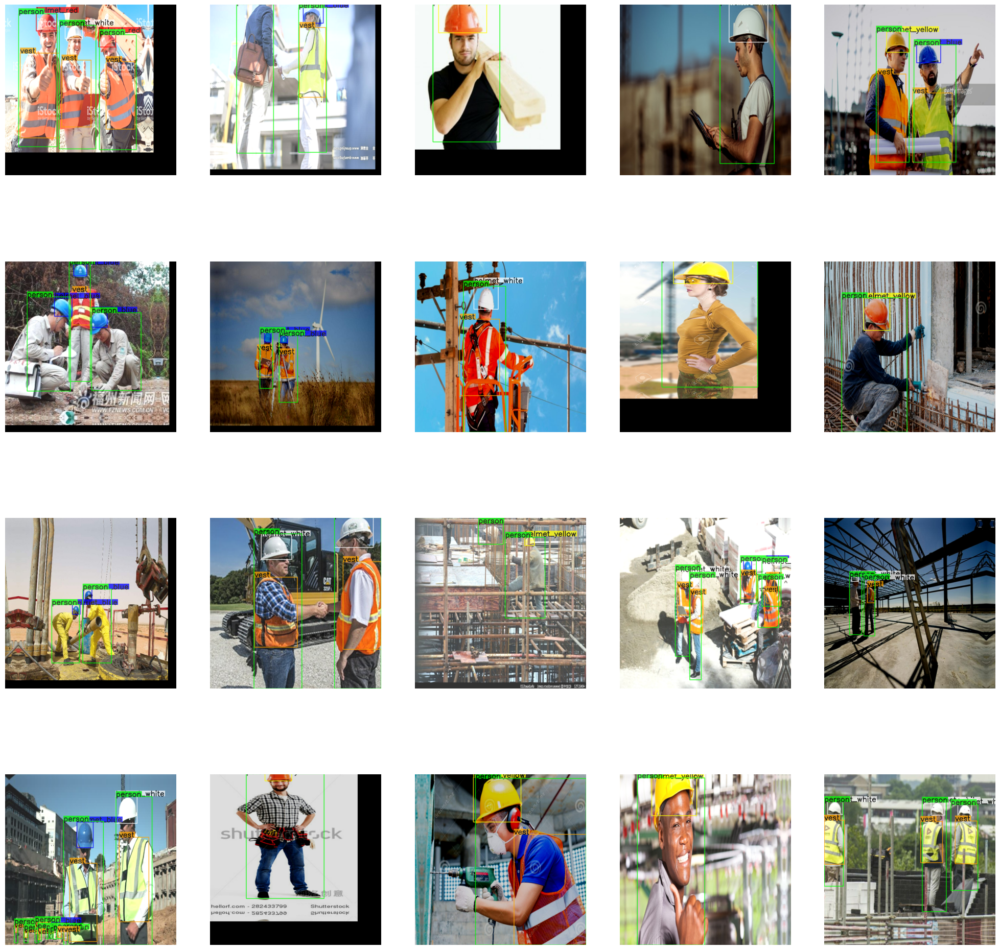

In [ ]:
visualize_dataset_gallery(train_dataset, color_map, idx_to_class_map, rows=4, cols=5)

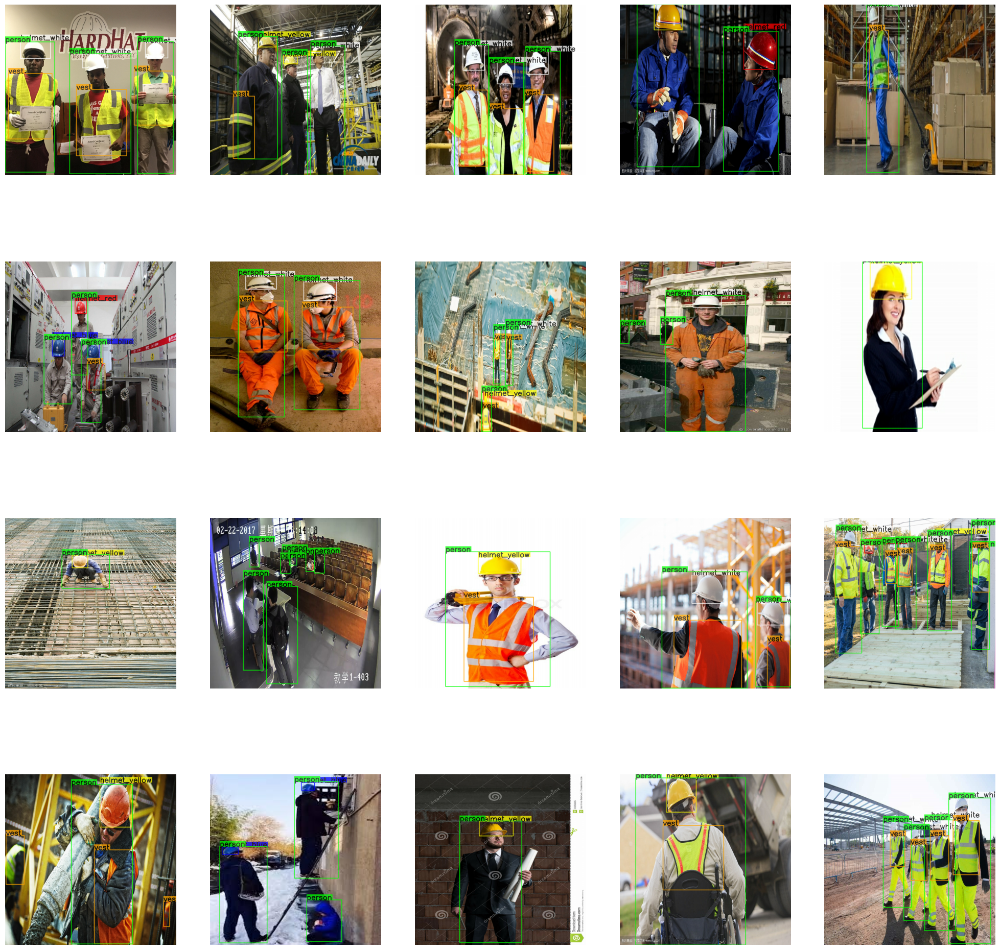

In [ ]:
visualize_dataset_gallery(validation_dataset, color_map, idx_to_class_map, rows=4, cols=5)

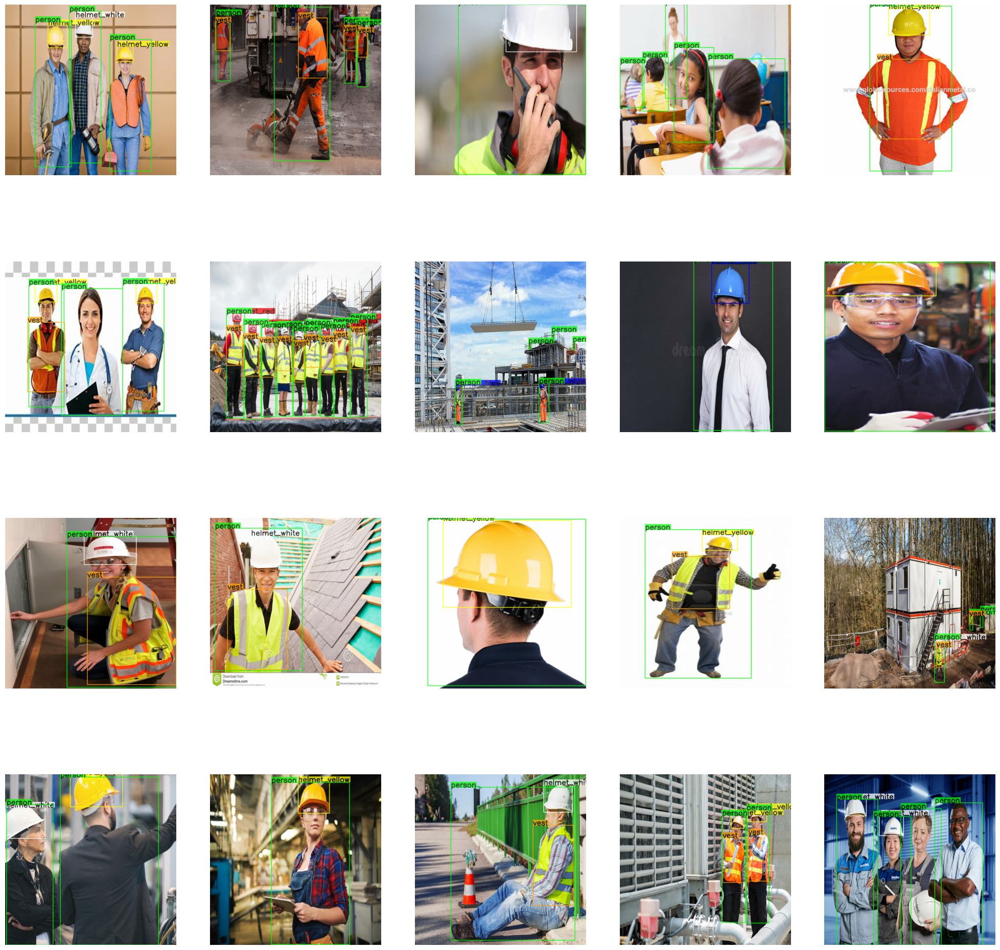

In [ ]:
visualize_dataset_gallery(test_dataset, color_map, idx_to_class_map, rows=4, cols=5)

#  2. Training

In [ ]:
def create_model(backbone=BACKBONE, bbox_format=BOUNDING_BOX_FORMAT, num_classes=NUM_CLASSES, prediction_decoder=None):
    backbone = keras_cv.models.YOLOV8Backbone.from_preset(backbone, load_weights=True)

    return keras_cv.models.YOLOV8Detector(
        backbone=backbone,
        num_classes=num_classes,
        bounding_box_format=bbox_format,
        fpn_depth=3,
        prediction_decoder = prediction_decoder
    )

In [ ]:
yolo_model = create_model()

In [ ]:
class EvaluateCOCOMetricsCallback(keras.callbacks.Callback):
    def __init__(self, data, save_path):
        super().__init__()
        self.data = data
        self.metrics = keras_cv.metrics.BoxCOCOMetrics(
            bounding_box_format=BOUNDING_BOX_FORMAT,
            evaluate_freq=1e9,
        )

        self.save_path = save_path
        self.best_map = -1.0

    def on_epoch_end(self, epoch, logs):
        self.metrics.reset_state()
        for batch in self.data:
            images, y_true = batch[0], batch[1]
            y_pred = self.model.predict(images, verbose=0)
            self.metrics.update_state(y_true, y_pred)

        metrics = self.metrics.result(force=True)
        logs.update(metrics)

        current_map = metrics["MaP"]
        if current_map > self.best_map:
            print(f"\nmAP improved from {self.best_map:.4f} to {current_map:.4f}. Saving model to {self.save_path}")
            self.best_map = current_map
            self.model.save(self.save_path)  # Save the model when mAP improves

        return logs

In [ ]:
coco_metrics_callback = EvaluateCOCOMetricsCallback(validation_dataset, "best_model.keras")
tensorboard_callback = keras.callbacks.TensorBoard(log_dir=LOG_DIR, update_freq="epoch")

In [ ]:
is_tensorboard_started = False

if not is_tensorboard_started:
    %load_ext tensorboard

    is_tensorboard_started = True
else:
    %reaload_ext tensorboard

%tensorboard --logdir {LOG_DIR}

<IPython.core.display.Javascript object>

In [ ]:
def scheduler(epoch, lr):
    updated_lr = INITIAL_LEARNING_RATE * ((1.0 - epoch / EPOCHS) * (1.0 - FINAL_LEARNING_RATE)) + FINAL_LEARNING_RATE
    print(f"Current LR: {updated_lr}")

    return updated_lr

In [ ]:
from keras.optimizers import Adam

optimizer = Adam(learning_rate=INITIAL_LEARNING_RATE)

In [ ]:
yolo_model.compile(
    optimizer=optimizer,
    box_loss="ciou",
    classification_loss="binary_crossentropy",
    jit_compile=False
)

In [ ]:
from keras.callbacks import LearningRateScheduler

scheduler_callback = LearningRateScheduler(scheduler)

In [ ]:
history = yolo_model.fit(
    train_dataset,
    validation_data=validation_dataset,
    epochs=EPOCHS,
    callbacks=[coco_metrics_callback, tensorboard_callback, scheduler_callback],
)

Current LR: 0.0020997999999999998
Epoch 1/200
216/216 ━━━━━━━━━━━━━━━━━━━━ 0s 137ms/step - box_loss: 3.6713 - class_loss: 49.9265 - loss: 53.5978
mAP improved from -1.0000 to 0.0000. Saving model to best_model.keras
216/216 ━━━━━━━━━━━━━━━━━━━━ 113s 237ms/step - box_loss: 3.6707 - class_loss: 49.7724 - loss: 53.4431 - val_box_loss: 3.5096 - val_class_loss: 1.1654 - val_loss: 4.6750 - MaP: 0.0000e+00 - MaP@[IoU=50]: 0.0000e+00 - MaP@[IoU=75]: 0.0000e+00 - MaP@[area=small]: 0.0000e+00 - MaP@[area=medium]: 0.0000e+00 - MaP@[area=large]: 0.0000e+00 - Recall@[max_detections=1]: 0.0000e+00 - Recall@[max_detections=10]: 0.0000e+00 - Recall@[max_detections=100]: 0.0000e+00 - Recall@[area=small]: 0.0000e+00 - Recall@[area=medium]: 0.0000e+00 - Recall@[area=large]: 0.0000e+00 - learning_rate: 0.0021
Current LR: 0.0020898009999999996
Epoch 2/200
216/216 ━━━━━━━━━━━━━━━━━━━━ 42s 190ms/step - box_loss: 3.2876 - class_loss: 0.9384 - loss: 4.2260 - val_box_loss: 3.3866 - val_class_loss: 1.1570 - val_

In [ ]:
for key in history.history.keys():
    print(f"{bold}{key}{reset}")

box_loss
class_loss
loss
val_box_loss
val_class_loss
val_loss
MaP
MaP@[IoU=50]
MaP@[IoU=75]
MaP@[area=small]
MaP@[area=medium]
MaP@[area=large]
Recall@[max_detections=1]
Recall@[max_detections=10]
Recall@[max_detections=100]
Recall@[area=small]
Recall@[area=medium]
Recall@[area=large]
learning_rate


In [ ]:
def plot_history(
    train_loss=None,
    val_loss=None,
    val_metric_primary=None,
    val_metric_50=None,
    colors=["blue", "green"],
    loss_legend_loc="upper center",
    acc_legend_loc="upper left",
    fig_size=(15, 10),

):

    plt.rcParams["figure.figsize"] = fig_size
    fig = plt.figure()
    fig.set_facecolor("white")

    # Loss Plots
    plt.subplot(2, 1, 1)

    train_loss_range = range(len(train_loss))
    plt.plot(
        train_loss_range,
        train_loss,
        color=f"tab:{colors[0]}",
        label=f"Train Loss",
    )

    validation_loss_range = range(len(val_loss))
    plt.plot(
        validation_loss_range,
        val_loss,
        color=f"tab:{colors[1]}",
        label=f"Validation Loss",
    )

    plt.ylabel("Loss")
    plt.legend(loc=loss_legend_loc)
    plt.gca().xaxis.set_major_locator(MaxNLocator(integer=True))
    plt.grid(True)
    plt.ylim([-0.20, 20.])
    plt.title("Training and Validation Loss")

    # Mean Average Precision Plots
    plt.subplot(2, 1, 2)

    val_metric_primary_range = range(len(val_metric_primary))
    plt.plot(
        val_metric_primary_range,
        val_metric_primary,
        color=f"tab:{colors[0]}",
        label=f"mAP@.50:.95",
    )

    val_metric_50_range = range(len(val_metric_50))
    plt.plot(
        val_metric_50_range,
        val_metric_50,
        color=f"tab:{colors[1]}",
        label=f"mAP@0.50",
    )

    plt.xlabel("Epoch")
    plt.ylabel("Mean Average Precision")
    plt.gca().xaxis.set_major_locator(MaxNLocator(integer=True))
    plt.legend(loc=acc_legend_loc)
    plt.grid(True)
    plt.title("Validation mAP")

    # fig.savefig("loss_MaP_plot.png")
    plt.show(block=block_plot)

    return

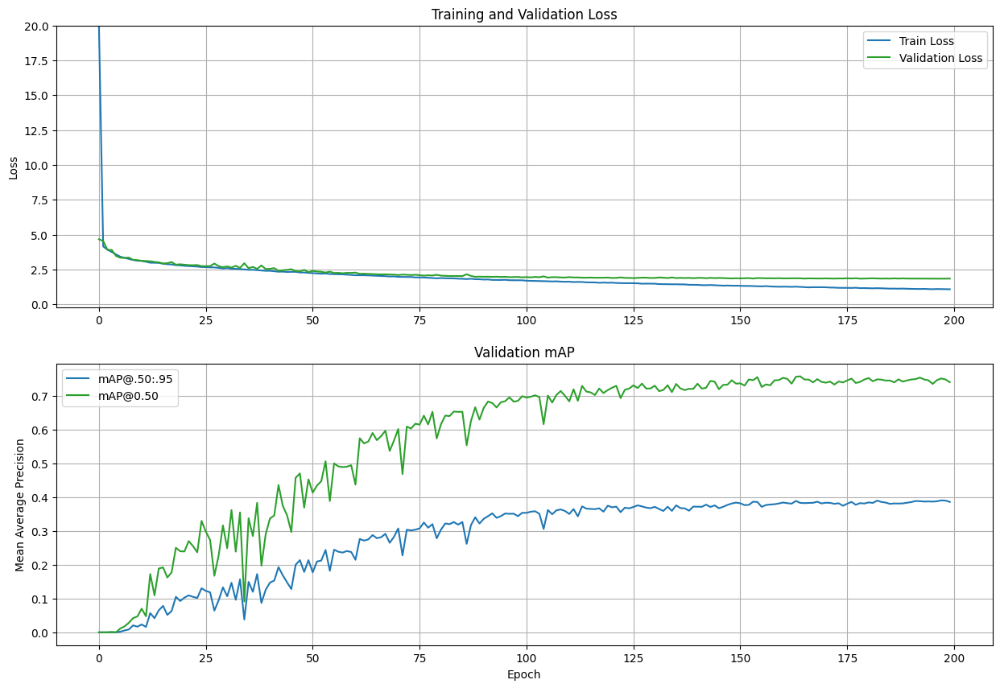

In [ ]:
loss = history.history["loss"]
val_mAP_primary = history.history["MaP"]

val_loss = history.history["val_loss"]
val_mAP_50 = history.history["MaP@[IoU=50]"]

plot_history(
    train_loss=loss,
    val_loss=val_loss,
    val_metric_primary=val_mAP_primary,
    val_metric_50=val_mAP_50,
    loss_legend_loc="best",
    acc_legend_loc="best",
)

In [ ]:
yolo_model.load_weights("best_model.keras")

In [ ]:
yolo_model.evaluate(validation_dataset)

54/54 ━━━━━━━━━━━━━━━━━━━━ 2s 35ms/step - box_loss: 1.6212 - class_loss: 0.1721 - loss: 1.7933


[1.843409776687622, 1.6698567867279053, 0.1735532134771347]

#  3. Inference

In [ ]:
def run_inference_on_random_images(test_dataset, model, class_names, color_map, num_images=3, rows=3, cols=3):
    # Convert dataset to a list of images and labels
    data = list(test_dataset.unbatch().take(100))  # Take first 100 samples (or full dataset if small)
    selected_samples = random.sample(data, num_images)

    plt.figure(figsize=(25, 25))  # Set the figure size to accommodate all the images in the grid

    for i, (img, _) in enumerate(selected_samples):
        img_batch = tf.expand_dims(img, axis=0)  # Add batch dimension

        predictions = model.predict(img_batch)

        # Decode predictions (depending on model architecture)
        boxes = predictions["boxes"][0]
        scores = predictions["confidence"][0]
        classes = predictions["classes"][0].astype(int)

        # Convert boxes, classes, and scores into tensors
        boxes = tf.convert_to_tensor(boxes)  # Convert to tensor
        classes = tf.convert_to_tensor(classes)  # Convert to tensor
        scores = tf.convert_to_tensor(scores)  # Convert to tensor

        # Draw bounding boxes on the image
        img_with_bboxes = draw_bbox(img.numpy().astype("uint8"), boxes, classes, color_map, class_names, scores)

        # Determine the position of the subplot
        row = i // cols  # Row index
        col = i % cols   # Column index

        # Create a subplot at the correct position
        plt.subplot(rows, cols, i+1)  # (rows, cols, index)
        plt.imshow(img_with_bboxes)
        plt.axis("off")
        plt.title(f"Prediction {i+1}")

    plt.tight_layout()  # Adjust the layout to ensure images are spaced nicely
    plt.show()

In [ ]:
rgb_color_map = {
    0: (0, 255, 0),  # Green - "person"
    1: (255, 165, 0),  # Orange - "vest"
    2: (0, 0, 255),  # Blue - "helmet_blue"
    3: (255, 0, 0),  # Red - "helmet_red"
    4: (255, 255, 255),  # White - "helmet_white"
    5: (255, 255, 0),  # Yellow - "helmet_yellow"
}

1/1 ━━━━━━━━━━━━━━━━━━━━ 4s 4s/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 107ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 108ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 102ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 104ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 101ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 100ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 104ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 105ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 105ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 100ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 106ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 107ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 102ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 105ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 101ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 103ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 101ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 101ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 103ms/step


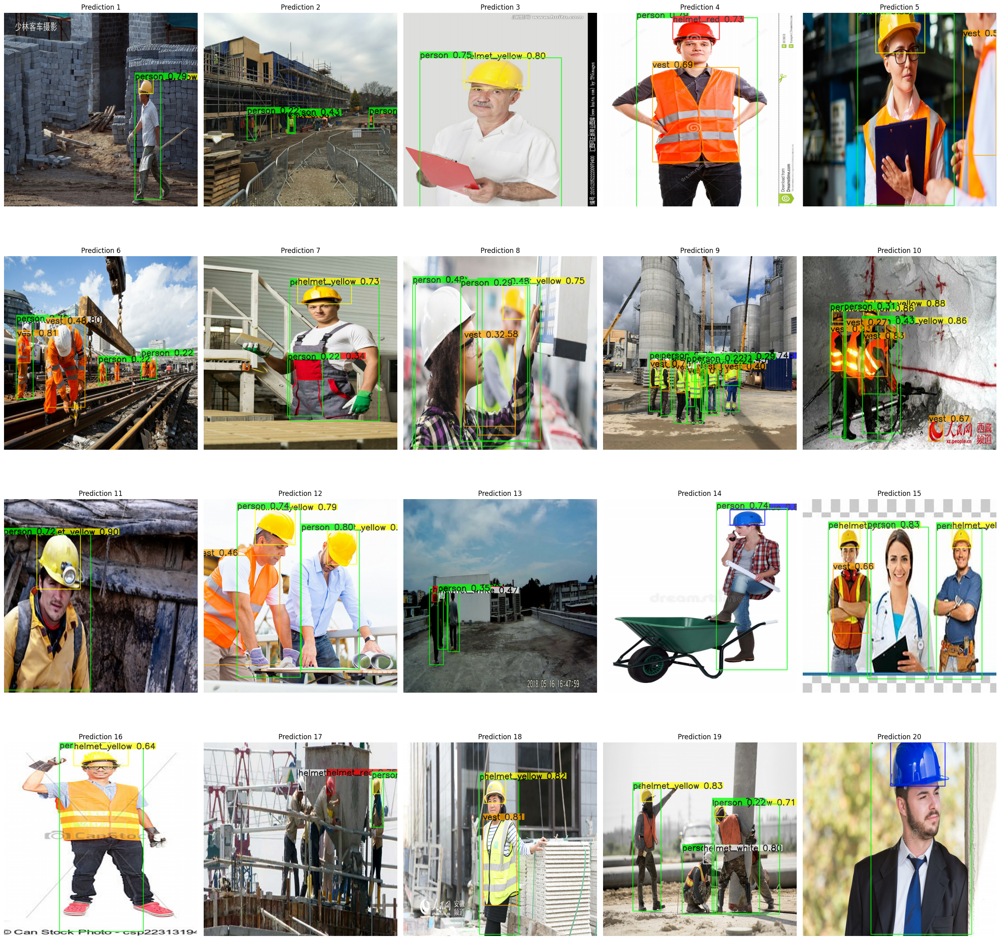

In [ ]:
run_inference_on_random_images(test_dataset, yolo_model, idx_to_class_map, rgb_color_map, num_images=20, rows=4, cols=5)

#  4. Evaluation Metric

**Evaluate the detection model on the Pascal VOC evaluation metric.**

The custom Pascal VOC evaluation script: [link](https://www.dropbox.com/s/sy8kb3eba1oce3w/calculate_voc_metric.py?dl=1).
---

<img src="https://learnopencv.com/wp-content/uploads/2022/05/COCO_evaluation.png" width=80%>

In [ ]:
test_dataset

<_PrefetchDataset element_spec=(TensorSpec(shape=(None, 640, 640, 3), dtype=tf.float32, name=None), {'classes': TensorSpec(shape=(None, 32), dtype=tf.float32, name=None), 'boxes': TensorSpec(shape=(None, 32, 4), dtype=tf.float32, name=None)})>

In [ ]:
import tensorflow as tf
import numpy as np
import pandas as pd
from tqdm import tqdm

def generate_predictions_csv(test_dataset, model, class_names,
                             output_csv="predictions.csv", num_samples=500, bbox_format='xyxy'):
    """
    Generate a CSV file from model predictions for VOC-style evaluation.

    Args:
        test_dataset: tf.data.Dataset with (images, bounding_boxes).
        model: Trained YOLO/KerasCV detection model.
        class_names: Dictionary mapping class IDs to class names.
        test_filenames: List of filenames corresponding to test images.
        output_csv: Output CSV filename.
        num_samples: Maximum number of test images for inference.
        bbox_format: Format of bounding boxes output by the model ('xyxy' or 'xywh').
    """
    results = []
    idx = 0

    print(f"Running inference on up to {num_samples} images...")
    for images, _ in tqdm(list(test_dataset)):

        for img in images:
            # print(img)
            if idx >= num_samples:
                break

            # img = img["images"]
            filename = test_filenames[idx]
            height, width = img.shape[:2]

            input_tensor = tf.expand_dims(img, axis=0)
            predictions = model.predict(input_tensor, verbose=0)

            boxes = predictions["boxes"][0]
            scores = predictions["confidence"][0]
            classes = predictions["classes"][0].astype(int)
            # print(classes)
            for box, score, cls_id in zip(boxes, scores, classes):
                if cls_id == -1 or score < 0.05:
                    continue

                class_name = class_names.get(cls_id, f"class_{cls_id}")

                # Convert bbox format if necessary
                if bbox_format == 'xyxy':
                    xmin, ymin, xmax, ymax = box
                elif bbox_format == 'xywh':
                    xmin, ymin, w, h = box
                    xmax, ymax = xmin + w, ymin + h
                else:
                    raise ValueError("bbox_format must be either 'xyxy' or 'xywh'")

                xmin_norm = np.clip(xmin / width, 0, 1)
                ymin_norm = np.clip(ymin / height, 0, 1)
                xmax_norm = np.clip(xmax / width, 0, 1)
                ymax_norm = np.clip(ymax / height, 0, 1)

                results.append({
                    "filename": filename,
                    "class": class_name,
                    "xmin": xmin_norm,
                    "ymin": ymin_norm,
                    "xmax": xmax_norm,
                    "ymax": ymax_norm,
                    "confidence": float(score)
                })
            idx += 1

        if idx >= num_samples:
            break

    df = pd.DataFrame(results)
    df.to_csv(output_csv, index=False)
    print(f"\n✅ CSV saved as: {output_csv}")

In [ ]:
generate_predictions_csv(test_dataset, yolo_model, idx_to_class_map, output_csv="predictions.csv", num_samples=500) # there should be 250 only but just in case

Running inference on up to 500 images...


100%|██████████| 63/63 [00:34<00:00,  1.81it/s]


✅ CSV saved as: predictions.csv


In [ ]:

import os
import argparse
import numpy as np
import pandas as pd
import tensorflow as tf
from urllib.request import urlopen
from tensorflow.keras.metrics import Mean


class MeanAveragePrecision:
    def __init__(self, *, classes, use_07_metric=False):

        self.classes = classes

        if "__background__" not in self.classes:
            self.classes.insert(0, "__background__")

        self.overlap_threshold = tf.constant(0.5)
        self.evaluator = Evaluator(use_07_metric=use_07_metric)

        self.cls_map_tracker = Mean(name="cls_map_tracker")
        self.mAP = tf.Variable(0.0, dtype=tf.float32)

        # Used to hold arrays for different classes
        self.arrays = Arrays(num_classes=len(classes))

    def update_state(self, pred, target):

        (fp_img, tp_img, confs_img, gts_img, idx2cls_img) = add_sample(pred, target, self.classes, self.overlap_threshold)
        self.arrays.update_arrays(fp_img, tp_img, confs_img, gts_img, idx2cls_img)

    def result(self):

        # MaP is calculated for one class at a time.

        for cls_idx in range(len(self.classes)):
            if tf.math.equal(self.classes[cls_idx], "__background__"):
                continue

            curr_cls_fp, curr_cls_tp, curr_cls_cf, curr_cls_gt = self.arrays.read_arrays(cls_idx=cls_idx)

            cls_ap = self.evaluator.evaluate_class(curr_cls_fp, curr_cls_tp, curr_cls_cf, curr_cls_gt)
            self.cls_map_tracker.update_state(cls_ap)
            print(f"Class {self.classes[cls_idx]:>13} AP: {cls_ap}")

        self.mAP.assign(self.cls_map_tracker.result())
        print(f"\nMean Average Precision: {self.mAP.read_value()}")

        return self.mAP


class Arrays(object):
    def __init__(self, num_classes=2):
        self.num_classes = num_classes
        self.fp_array = tf.Variable([-1.0], dtype=tf.float32, shape=tf.TensorShape(None), validate_shape=False)
        self.tp_array = tf.Variable([-1.0], dtype=tf.float32, shape=tf.TensorShape(None), validate_shape=False)
        self.cf_array = tf.Variable([-1.0], dtype=tf.float32, shape=tf.TensorShape(None), validate_shape=False)

        self.gt = tf.Variable(tf.zeros(self.num_classes, dtype=tf.int32))

        # Each value in the array represents the class that particular index belongs to
        self.idx2cls = tf.Variable([-1], dtype=tf.int32, shape=tf.TensorShape(None), validate_shape=False)

    def update_arrays(self, new_fp, new_tp, new_conf, new_gt, new_idx2cls):
        # Read old values
        fp_old = self.fp_array.read_value()
        tp_old = self.tp_array.read_value()
        cf_old = self.cf_array.read_value()
        idx2cls_old = self.idx2cls.read_value()

        # Merge old and new values
        new_fp = tf.concat([fp_old, new_fp], axis=0)
        new_tp = tf.concat([tp_old, new_tp], axis=0)
        new_conf = tf.concat([cf_old, new_conf], axis=0)
        new_idx2cls = tf.concat([idx2cls_old, new_idx2cls], axis=0)

        # Update fp, tp, cf and idx2cls arrays
        self.fp_array.assign(new_fp)
        self.tp_array.assign(new_tp)
        self.cf_array.assign(new_conf)
        self.idx2cls.assign(new_idx2cls)

        # Add the number of new GTs
        self.gt.assign_add(new_gt)

        return self.fp_array, self.tp_array, self.cf_array, self.gt, self.idx2cls

    def read_arrays(self, cls_idx=-1):

        # Return all
        if cls_idx == -1:
            # [1:] is done because we had initialized the variable with a placeholder element --> -1. which is not required.
            return self.fp_array[1:], self.tp_array[1:], self.cf_array[1:], self.gt, self.idx2cls[1:]

        # Return class specific elements
        else:
            # Return elements that belong to class denoted by cls_idx
            matching_idxs = tf.squeeze(tf.where(self.idx2cls == cls_idx), axis=1)

            cls_fp = tf.gather(self.fp_array, matching_idxs)
            cls_tp = tf.gather(self.tp_array, matching_idxs)
            cls_conf = tf.gather(self.cf_array, matching_idxs)
            cls_gt = self.gt[cls_idx]

            return cls_fp, cls_tp, cls_conf, cls_gt


def add_sample(all_detections, gt_boxes, classes, overlap_thresh):

    fp_per_img = tf.TensorArray(tf.float32, infer_shape=False, size=tf.size(classes))
    tp_per_img = tf.TensorArray(tf.float32, infer_shape=False, size=tf.size(classes))
    confs_per_img = tf.TensorArray(tf.float32, infer_shape=False, size=tf.size(classes))
    gt_per_img = tf.TensorArray(tf.int32, infer_shape=False, size=tf.size(classes))

    # Each element represents the CLASS that index belongs to.
    cls_idx_info = tf.TensorArray(tf.int32, infer_shape=False, size=tf.size(classes))

    cls_column = tf.gather(all_detections, indices=5, axis=1)
    all_detections = tf.gather(all_detections, indices=[0, 1, 2, 3, 4], axis=1)

    for class_idx in range(len(classes)):
        if tf.math.equal(classes[class_idx], "__background__"):
            fp_per_img = fp_per_img.write(class_idx, [0.0])
            tp_per_img = tp_per_img.write(class_idx, [0.0])
            confs_per_img = confs_per_img.write(class_idx, [0.0])
            gt_per_img = gt_per_img.write(class_idx, [0])
            cls_idx_info = cls_idx_info.write(class_idx, [class_idx])
            continue

        # For GT
        # ---------------------------------
        # Collect GT for the current (Class) class_idx and
        # initialize an array to indicate whether the GT box has been detected
        gt_cls_idxs = tf.squeeze(tf.where(tf.gather(gt_boxes, indices=4, axis=1) == tf.cast(class_idx, tf.float32)), axis=1)
        gt_counter_per_class = tf.size(gt_cls_idxs)

        gt_cls_record = tf.gather(gt_boxes, gt_cls_idxs)
        gt_cls_detected = tf.fill((gt_counter_per_class,), False)
        gt_per_img = gt_per_img.write(class_idx, [gt_counter_per_class])
        # ---------------------------------

        # For Predictions
        # ---------------------------------
        matching_idxs = tf.squeeze(tf.where(cls_column == class_idx), axis=1)
        cls_detections = tf.gather(all_detections, matching_idxs)

        BBs_for_cls = tf.gather(cls_detections, indices=(0, 1, 2, 3), axis=1)
        confs_for_cls = tf.gather(cls_detections, indices=4, axis=1)
        num_detections = tf.shape(BBs_for_cls)[0]
        # ---------------------------------

        # Calculate FP and TP for each predicted bbox
        fp = tf.zeros(num_detections, dtype=tf.float32)
        tp = tf.zeros(num_detections, dtype=tf.float32)

        for idx in tf.range(num_detections):
            ovmax = -float("inf")
            idx_max = tf.constant(0, dtype=tf.int32)

            bb = tf.gather(BBs_for_cls, idx)

            if gt_counter_per_class > 0:
                ovmax, idx_max = calculate_overlap(gt_cls_record, bb)

            if ovmax > overlap_thresh:
                if not tf.gather(gt_cls_detected, idx_max):
                    tp = tf.tensor_scatter_nd_update(tp, [[idx]], [1.0])
                    gt_cls_detected = tf.tensor_scatter_nd_update(gt_cls_detected, [[idx_max]], [True])
                else:
                    fp = tf.tensor_scatter_nd_update(fp, [[idx]], [1.0])
            else:
                fp = tf.tensor_scatter_nd_update(fp, [[idx]], [1.0])

        if num_detections > 0:
            fp_per_img = fp_per_img.write(class_idx, fp)
            tp_per_img = tp_per_img.write(class_idx, tp)
            confs_per_img = confs_per_img.write(class_idx, confs_for_cls)
            cls_idx_info = cls_idx_info.write(class_idx, tf.fill((num_detections,), class_idx))
        else:
            fp_per_img = fp_per_img.write(class_idx, [0.0])
            tp_per_img = tp_per_img.write(class_idx, [0.0])
            confs_per_img = confs_per_img.write(class_idx, [0.0])
            cls_idx_info = cls_idx_info.write(class_idx, [class_idx])

    # Return 1D arrays
    return fp_per_img.concat(), tp_per_img.concat(), confs_per_img.concat(), gt_per_img.concat(), cls_idx_info.concat()


def calculate_overlap(BBGT, bb):

    BBGT_xmin = tf.gather(BBGT, indices=0, axis=1)
    BBGT_ymin = tf.gather(BBGT, indices=1, axis=1)
    BBGT_xmax = tf.gather(BBGT, indices=2, axis=1)
    BBGT_ymax = tf.gather(BBGT, indices=3, axis=1)

    inter_xmin = tf.math.maximum(BBGT_xmin, bb[0])
    inter_ymin = tf.math.maximum(BBGT_ymin, bb[1])
    inter_xmax = tf.math.minimum(BBGT_xmax, bb[2])
    inter_ymax = tf.math.minimum(BBGT_ymax, bb[3])

    inter_width = inter_xmax - inter_xmin + 1.0
    inter_height = inter_ymax - inter_ymin + 1.0

    intersection = inter_width * inter_height

    bb_areas = (bb[2] - bb[0] + 1.0) * (bb[3] - bb[1] + 1.0)
    BBGT_areas = (BBGT_xmax - BBGT_xmin + 1.0) * (BBGT_ymax - BBGT_ymin + 1.0)

    union = bb_areas + BBGT_areas - intersection

    iou = tf.math.divide_no_nan(intersection, union)
    idx_max_iou = tf.math.argmax(iou, output_type=tf.int32)
    max_iou = iou[idx_max_iou]

    return max_iou, idx_max_iou


class Evaluator:
    def __init__(self, use_07_metric=True):
        self.ap = tf.Variable(0.0, dtype=tf.float32)
        self.p = tf.Variable(-1.0, dtype=tf.float32)

        self.use_07_metric = use_07_metric

    def evaluate_class(self, fp_cls, tp_cls, confs_cls, gt_cls):

        # global sorting in descending order
        sorted_idx = tf.argsort(confs_cls, direction="DESCENDING")

        # arrange FP and TP collected from all images in descending order of their confidences
        fp_cls = tf.gather(fp_cls, indices=sorted_idx)
        tp_cls = tf.gather(tp_cls, indices=sorted_idx)

        fp_cs = tf.math.cumsum(fp_cls)
        tp_cs = tf.math.cumsum(tp_cls)

        recall = tf.math.divide_no_nan(tp_cs, tf.cast(gt_cls, tf.float32))
        precision = tf.math.divide_no_nan(tp_cs, tf.math.maximum(tf.math.add(tp_cs, fp_cs), 1e-8))

        average_precision_class = self.voc_ap(recall, precision, use_07_metric=self.use_07_metric) * 100.0
        return average_precision_class

    def voc_ap(self, recall, precision, use_07_metric=False):
        # reset ap and p
        self.ap.assign(0.0)
        self.p.assign(-1.0)

        if use_07_metric:
            for threshold in tf.range(0.00, 1.01, 0.01, dtype=tf.float32):
                ax = tf.math.reduce_sum(tf.where(recall >= threshold, 1, 0))

                if tf.math.equal(ax, tf.constant(0, dtype=tf.int32)):
                    self.p.assign(0.0)
                    # p = 0.0
                else:
                    idxs = tf.squeeze(tf.where(recall >= threshold), axis=1)
                    temp_p = tf.math.reduce_max(tf.gather(precision, indices=idxs))
                    self.p.assign(temp_p)

                self.ap.assign_add(tf.math.divide_no_nan(self.p, 101.0))

        else:
            # correct AP calculation
            # first append sentinel values at the end
            mean_recall = tf.concat([[0.0], recall, [1.0]], axis=0)
            mean_precision = tf.concat([[0.0], precision, [0.0]], axis=0)

            for idx in tf.range(tf.size(mean_precision) - 1, 0, -1):

                value = tf.math.maximum(mean_precision[idx - 1], mean_precision[idx])
                mean_precision = tf.tensor_scatter_nd_update(
                    tensor=mean_precision,
                    indices=[[idx - 1]],
                    updates=[value],
                )

            # to calculate area under PR curve, look for points
            # where X axis (recall) changes value
            idxs = tf.squeeze(tf.where(mean_recall[1:] != mean_recall[:-1]), 1)

            # and sum (Delta recall) * precision
            self.ap.assign(
                tf.math.reduce_sum(
                    tf.math.multiply(
                        tf.math.subtract(tf.gather(mean_recall, indices=idxs + 1), tf.gather(mean_recall, indices=idxs)),
                        tf.gather(mean_precision, indices=idxs + 1),
                    )
                )
            )

        return self.ap.value()


def download_file():

    file_name = "all_test.csv"
    url = "https://www.dropbox.com/s/irqsw8cubp1ybye/all_test.csv?dl=1"

    with urlopen(url) as resp, open(file_name, "wb") as file:
        file.write(resp.read())

    print("File downloaded.")

    return


def process_csv(gt_csv_path, pred_csv_path, class_list):

    groundtruth_df = pd.read_csv(gt_csv_path)
    prediction_df = pd.read_csv(pred_csv_path)

    classes = {i: value for i, value in enumerate(class_list, 1)}
    rev_classes = {value: key for key, value in classes.items()}

    groundtruth_df["class"] = groundtruth_df["class"].map(rev_classes)
    prediction_df["class"] = prediction_df["class"].map(rev_classes)

    # Rearange columns
    groundtruth_df = groundtruth_df[["filename", "width", "height", "xmin", "ymin", "xmax", "ymax", "class"]]
    prediction_df = prediction_df[["filename", "xmin", "ymin", "xmax", "ymax", "confidence", "class"]]

    return groundtruth_df, prediction_df


def calculate_map(gt_csv_path, pred_csv_path):

    class_list = ("person", "vest", "helmet_blue", "helmet_red", "helmet_white", "helmet_yellow")
    voc_map = MeanAveragePrecision(classes=list(class_list), use_07_metric=False)

    groundtruth_df, prediction_df = process_csv(gt_csv_path, pred_csv_path, class_list)

    gt_filenames = groundtruth_df["filename"].unique()

    for idx, filename in enumerate(gt_filenames, 1):

        print(f"\r{idx:03}. {filename}", end="")

        gt_rows = groundtruth_df.loc[groundtruth_df["filename"] == filename]

        image_width = gt_rows["width"].values[0]
        image_height = gt_rows["height"].values[0]

        gt_rows = gt_rows.drop(["filename", "width", "height"], axis=1)

        pred_rows = prediction_df.loc[prediction_df["filename"] == filename].drop("filename", axis=1)
        pred_rows.loc[pred_rows.index, "xmin"] = pred_rows[["xmin"]].values * image_width
        pred_rows.loc[pred_rows.index, "ymin"] = pred_rows[["ymin"]].values * image_height
        pred_rows.loc[pred_rows.index, "xmax"] = pred_rows[["xmax"]].values * image_width
        pred_rows.loc[pred_rows.index, "ymax"] = pred_rows[["ymax"]].values * image_height

        # Sorting for sanity check and consistency.
        pred_rows = pred_rows.sort_values(by="confidence", axis=0, ascending=False)

        # pred_rows = pred_rows.drop(pred_rows[pred_rows.confidence < 1 / len(class_list)].index)

        # pred = [[x1: float, y1: float, x2: float, y2: float, conf: float, class_id: float]]
        # target   = [[x1: float, y1: float, x2: float, y2: float, class_id: float]]

        pred = tf.convert_to_tensor(pred_rows.to_numpy(dtype=np.float32))
        target = tf.convert_to_tensor(gt_rows.to_numpy(dtype=np.float32))

        voc_map.update_state(pred, target)
    print()

    mAP = voc_map.result()

    return mAP

In [ ]:
gt_csv_path = r"/content/all_test.csv"

if not os.path.exists(gt_csv_path):
    download_file()

pred_csv_path = '/content/predictions.csv'

calculate_map(gt_csv_path, pred_csv_path)

File downloaded.
250. ppe_1317.jpg
Class        person AP: 75.95679473876953
Class          vest AP: 65.84795379638672
Class   helmet_blue AP: 72.79402160644531
Class    helmet_red AP: 64.81745147705078
Class  helmet_white AP: 72.9461441040039
Class helmet_yellow AP: 73.53299713134766

Mean Average Precision: 70.98255920410156


<tf.Variable 'Variable:0' shape=() dtype=float32, numpy=70.98255920410156>

# 5. Run Inference on a Video


#### [Download the input video](https://www.dropbox.com/s/pvnc0u0dk41ji4w/Project_4_evaluation_video.mp4?dl=1)

In [ ]:
from IPython.display import YouTubeVideo, display

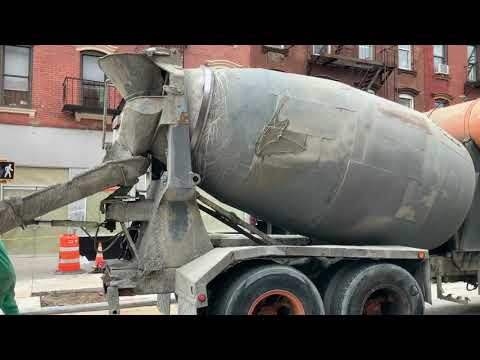

In [ ]:
# https://www.youtube.com/watch?v=mYc-jb-9N3Y

video = YouTubeVideo("mYc-jb-9N3Y", width=640, height=360)
display(video)

In [ ]:
import locale
locale.getpreferredencoding = lambda: "UTF-8"

In [ ]:
pip install pytubefix

   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 732.0/732.0 kB 42.7 MB/s eta 0:00:00


In [ ]:
from pytubefix import YouTube

In [ ]:
# YouTube video URL
video_url = "https://www.youtube.com/watch?v=4tIol2grX_U"

# Download the video
yt = YouTube(video_url)
stream = yt.streams.filter(file_extension='mp4').first()
stream.download('/content')

'/content/Object Detection Before Video   Colored Helmet and Vest.mp4'

In [ ]:
video_path = "/content/Object Detection Before Video   Colored Helmet and Vest.mp4"
print(os.path.exists(video_path))

True


In [ ]:
def preprocess_frame(frame):
    frame = cv2.cvtColor(frame, cv2.COLOR_BGR2RGB)
    frame = tf.image.resize(frame, (640, 640))  # Resize
    return tf.expand_dims(frame, axis=0)

def draw_bbox(image, boxes, class_ids, color_map, class_map, scores=None):
    overlay = image.copy()

    text_tickness = 2
    font_scale = 0.9
    font = cv2.FONT_HERSHEY_SIMPLEX

    for idx, bbox in enumerate(boxes):
        xmin, ymin, xmax, ymax = bbox.astype(int)
        class_id = int(class_ids[idx])

        if class_id == -1:  # Skip data filled with dense tensor
            continue

        color = color_map[class_id]
        class_name = class_map[class_id]

        if scores is not None:
            score = scores[idx]
            class_name = f"{class_name} {score:.2f}"

        textsize, _ = cv2.getTextSize(class_name, font, font_scale, text_tickness)

        # Draw a rectangle for class name background
        cv2.rectangle(overlay, (xmin, ymin), (xmin + textsize[0], ymin - textsize[1]), color, -1)

        # Draw a rectangle for bounding box
        cv2.rectangle(overlay, (xmin, ymin), (xmax, ymax), color, 2)

        # Draw class name
        cv2.putText(overlay, class_name, (xmin, ymin), font, font_scale, (0, 0, 0), text_tickness)

    return cv2.addWeighted(overlay, 0.75, image, 0.25, 0)


# Open video file
video_path = video_path
cap = cv2.VideoCapture(video_path)

# Get video properties
fps = int(cap.get(cv2.CAP_PROP_FPS))
frame_width = int(cap.get(cv2.CAP_PROP_FRAME_WIDTH))
frame_height = int(cap.get(cv2.CAP_PROP_FRAME_HEIGHT))

# Define output video writer
output_path = "output_video.mp4"
fourcc = cv2.VideoWriter_fourcc(*"mp4v")  # Codec for MP4
out = cv2.VideoWriter(output_path, fourcc, fps, (frame_width, frame_height))

while cap.isOpened():
    ret, frame = cap.read()
    if not ret:
        break  # Exit loop if video ends

    original_height, original_width, _ = frame.shape
    input_tensor = preprocess_frame(frame)
    preds = yolo_model.predict(input_tensor)
    # print("Predictions:", preds)

    boxes = preds["boxes"][0]       # Shape: (100, 4)
    scores = preds["confidence"][0] # Shape: (100,)
    class_ids = preds["classes"][0] # Shape: (100,)

    valid_indices = np.where(preds['confidence'] > 0.5)  # Keep only predictions with confidence > 0.5
    valid_boxes = preds['boxes'][valid_indices]
    valid_confidence = preds['confidence'][valid_indices]
    valid_classes = preds['classes'][valid_indices]

    # Calculate scaling factors
    scale_x = 640 / original_width
    scale_y = 640 / original_height

    # Rescale box coordinates back to original image size
    rescaled_boxes = []
    for box in valid_boxes:
        x1_resized, y1_resized, x2_resized, y2_resized = box
        x1 = int(x1_resized / scale_x)
        y1 = int(y1_resized / scale_y)
        x2 = int(x2_resized / scale_x)
        y2 = int(y2_resized / scale_y)
        rescaled_boxes.append([x1, y1, x2, y2])

    # Convert rescaled boxes to numpy array
    rescaled_boxes = np.array(rescaled_boxes)

    # Now use your draw_bbox function
    frame = draw_bbox(frame, rescaled_boxes, valid_classes, color_map, idx_to_class_map, scores=valid_confidence)

    # Write processed frame to output video
    print("Writing frame...")
    out.write(frame)

# Release resources
cap.release()
out.release()
print(f"✅ Processed video saved at {output_path}")


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 119ms/step
Writing frame...
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 104ms/step
Writing frame...
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 103ms/step
Writing frame...
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 108ms/step
Writing frame...
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 105ms/step
Writing frame...
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 106ms/step
Writing frame...
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 106ms/step
Writing frame...
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 108ms/step
Writing frame...
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 105ms/step
Writing frame...
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 108ms/step
Writing frame...
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 103ms/step
Writing frame...
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 104ms/step
Writing frame...
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 108ms/step
Writing frame...
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 113ms/step
Writing frame...
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 124ms/step
Writing frame...
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 108ms/step
Writing frame...
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 116ms/step
Writing frame...
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 120ms/step
Writing f

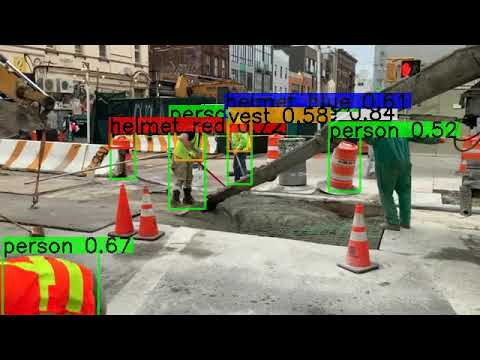

In [ ]:
# https://www.youtube.com/watch?v=Dip1sJsIk5s

video = YouTubeVideo("Dip1sJsIk5s", width=640, height=360)
display(video)

Here is the link to my Youtube video: https://www.youtube.com/watch?v=Dip1sJsIk5s